In [106]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import math

In [3]:
covid_df = pd.read_csv('country_vaccinations.csv', parse_dates=True)

In [4]:
covid_df.head()

,country,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,vaccines,source_name,source_website
0,Algeria,DZA,2021-01-29,0.0,NaN,NaN,NaN,NaN,0.00,NaN,NaN,NaN,Sputnik V,Ministry of Health,https://www.aps.dz/regions/116777-blida-covid-...
1,Algeria,DZA,2021-01-30,30.0,NaN,NaN,30.0,30.0,0.00,NaN,NaN,1.0,Sputnik V,Ministry of Health,https://www.aps.dz/regions/116777-blida-covid-...
2,Andorra,AND,2021-01-25,576.0,576.0,NaN,NaN,NaN,0.75,0.75,NaN,NaN,Pfizer/BioNTech,Government of Andorra,https://www.govern.ad/comunicats/item/12379-se...
3,Andorra,AND,2021-01-26,NaN,NaN,NaN,NaN,66.0,NaN,NaN,NaN,854.0,Pfizer/BioNTech,Government of Andorra,https://www.govern.ad/comunicats/item/12379-se...
4,Andorra,AND,2021-01-27,NaN,NaN,NaN,NaN,66.0,NaN,NaN,NaN,854.0,Pfizer/BioNTech,Government of Andorra,https://www.govern.ad/comunicats/item/12379-se...


In [5]:
covid_df.profile_report()

Summarize dataset:   0%|          | 0/29 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [15]:
covid_df.columns

Index(['country', 'iso_code', 'date', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated',
       'daily_vaccinations_raw', 'daily_vaccinations',
       'total_vaccinations_per_hundred', 'people_vaccinated_per_hundred',
       'people_fully_vaccinated_per_hundred', 'daily_vaccinations_per_million',
       'vaccines', 'source_name', 'source_website'],
      dtype='object')

In [17]:
covid_df.select_dtypes(include=['float'])

,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million
0,0.0,NaN,NaN,NaN,NaN,0.00,NaN,NaN,NaN
1,30.0,NaN,NaN,30.0,30.0,0.00,NaN,NaN,1.0
2,576.0,576.0,NaN,NaN,NaN,0.75,0.75,NaN,NaN
3,NaN,NaN,NaN,NaN,66.0,NaN,NaN,NaN,854.0
4,NaN,NaN,NaN,NaN,66.0,NaN,NaN,NaN,854.0
...,...,...,...,...,...,...,...,...,...
2550,491786.0,490570.0,1216.0,28129.0,22149.0,15.60,15.56,0.04,7025.0
2551,524677.0,523042.0,1635.0,32891.0,23101.0,16.64,16.59,0.05,7327.0
2552,559468.0,556997.0,2471.0,34791.0,25788.0,17.74,17.67,0.08,8179.0
2553,592228.0,589622.0,2606.0,32760.0,26854.0,18.78,18.70,0.08,8517.0


In [18]:
covid_df.select_dtypes(include=['datetime64'])

""
0
1
2
3
4
...
2550
2551
2552
2553


In [11]:
covid_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2555 entries, 0 to 2554
Data columns (total 15 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   country                              2555 non-null   object 
 1   iso_code                             2318 non-null   object 
 2   date                                 2555 non-null   object 
 3   total_vaccinations                   1667 non-null   float64
 4   people_vaccinated                    1355 non-null   float64
 5   people_fully_vaccinated              805 non-null    float64
 6   daily_vaccinations_raw               1368 non-null   float64
 7   daily_vaccinations                   2458 non-null   float64
 8   total_vaccinations_per_hundred       1667 non-null   float64
 9   people_vaccinated_per_hundred        1355 non-null   float64
 10  people_fully_vaccinated_per_hundred  805 non-null    float64
 11  daily_vaccinations_per_million

In [21]:
type(covid_df['date'][0])

str

In [5]:
covid_df['date_formatted'] = pd.to_datetime(covid_df.date, format='%Y-%m-%d') 

In [6]:
my_report = sv.analyze(covid_df)
my_report.show_html()

                                             |                                                                …

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [7]:
covid_df.profile_report()

Summarize dataset:   0%|          | 0/30 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [26]:
covid_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2555 entries, 0 to 2554
Data columns (total 16 columns):
 #   Column                               Non-Null Count  Dtype         
---  ------                               --------------  -----         
 0   country                              2555 non-null   object        
 1   iso_code                             2318 non-null   object        
 2   date                                 2555 non-null   object        
 3   total_vaccinations                   1667 non-null   float64       
 4   people_vaccinated                    1355 non-null   float64       
 5   people_fully_vaccinated              805 non-null    float64       
 6   daily_vaccinations_raw               1368 non-null   float64       
 7   daily_vaccinations                   2458 non-null   float64       
 8   total_vaccinations_per_hundred       1667 non-null   float64       
 9   people_vaccinated_per_hundred        1355 non-null   float64       
 10  people_fully

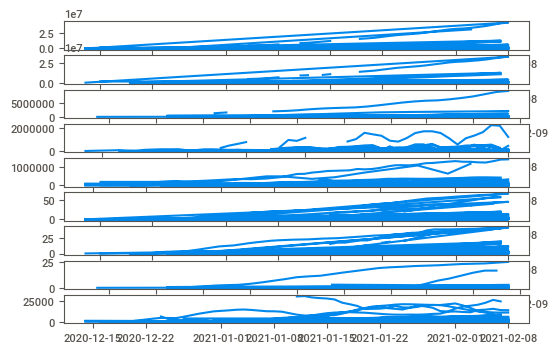

<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

In [44]:
# do this if we have a time based dataset:
fig, axes = plt.subplots(len(covid_df.select_dtypes(include=['float']).columns))
for iterator in zip(axes, covid_df.select_dtypes(include=['float']).columns):
    ax = iterator[0]
    column = iterator[1]
    x = covid_df['date_formatted']
    y = covid_df[column]
    plt.figure(figsize = (10,10))
    ax.plot(x,y)


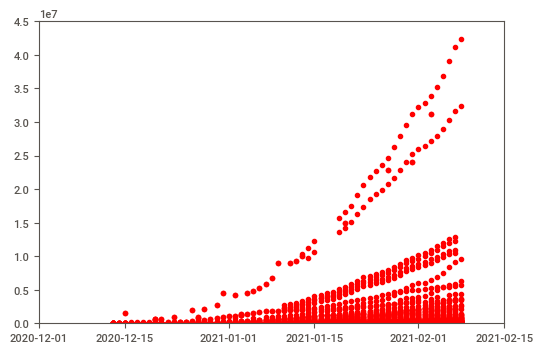

In [61]:
for column in covid_df.select_dtypes(include=['float']).columns:
    x = covid_df['date_formatted']
    y = covid_df[column]
    plt.plot(x,y,'ro')
    plt.axis(['2020-12-01','2021-02-15', 0, 45000000])

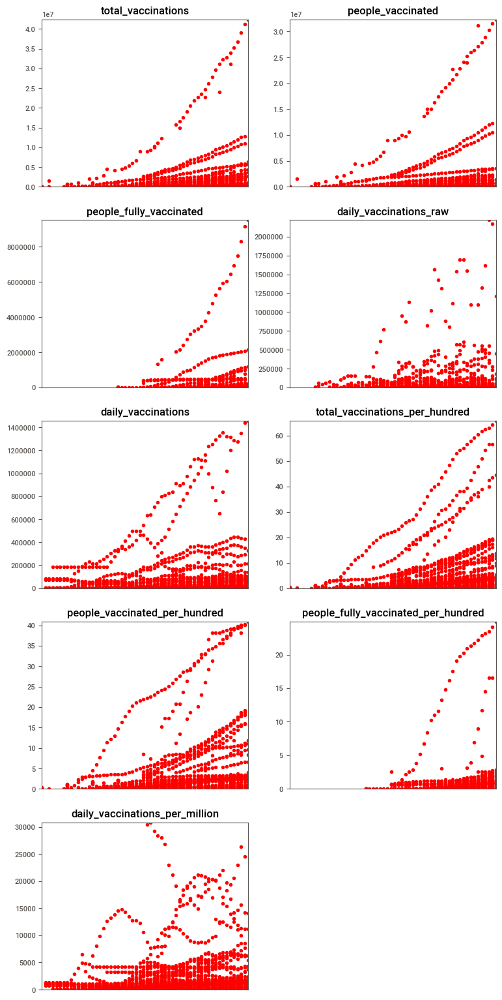

In [121]:
plt.figure(figsize=(9, 36))
for column,i in zip(covid_df.select_dtypes(include=['float']).columns,range(len(covid_df.select_dtypes(include=['float']).columns))):
    x = covid_df['date_formatted']
    y = covid_df[column]
    plt.subplot(len(covid_df.select_dtypes(include=['float']).columns),2,i+1)
    plt.title(column)
    plt.axis([min(covid_df['date_formatted']),max(covid_df['date_formatted']),0,covid_df[column].max()])
    frame = plt.gca()
    frame.axes.get_xaxis().set_visible(False)
    plt.plot(x,y,'ro')

In [93]:
min(covid_df['date_formatted'])

Timestamp('2020-12-13 00:00:00')

In [109]:
math.isnan(max(covid_df['people_vaccinated']))

True

In [112]:
covid_df['people_vaccinated'].min()

0.0

In [110]:
covid_df['people_vaccinated']

0            NaN
1            NaN
2          576.0
3            NaN
4            NaN
          ...   
2550    490570.0
2551    523042.0
2552    556997.0
2553    589622.0
2554    603976.0
Name: people_vaccinated, Length: 2555, dtype: float64

In [71]:
data = {'a': np.arange(50),
        'c': np.random.randint(0, 50, 50),
        'd': np.random.randn(50)}

In [72]:
data['d']

array([ 0.50266387, -0.38272157, -0.98124801, -1.09480632, -0.59583443,
        0.24411715,  0.34404497,  0.23707541, -1.35393635, -0.24788614,
       -0.66477049,  0.53066462, -0.89781811,  1.08217043,  0.56723999,
        1.06705063,  0.06501662,  1.49632173, -1.0077384 , -0.77770815,
       -0.60371181, -0.11781539,  1.97265955, -0.72640777, -0.00495858,
       -1.1983232 , -0.9788218 , -1.53890544, -0.32914456, -0.69232106,
       -0.77992516,  1.53375565, -0.24595713,  0.73993882, -0.83025777,
       -1.3506012 ,  0.78795608, -0.36292957, -0.080759  , -0.19429444,
        0.85354959, -2.19597124,  1.70173178,  0.37183261,  0.21412644,
        0.7731781 , -0.57267887, -0.03588719,  1.24468912,  0.61271587])

In [73]:
data['b'] = data['a'] + 10 * np.random.randn(50)
data['d'] = np.abs(data['d']) * 100

In [74]:
data['d']

array([ 50.26638704,  38.27215673,  98.12480137, 109.48063205,
        59.58344263,  24.41171512,  34.40449709,  23.70754128,
       135.39363499,  24.78861351,  66.47704928,  53.06646216,
        89.78181073, 108.21704252,  56.72399931, 106.70506273,
         6.5016618 , 149.63217333, 100.77383952,  77.77081489,
        60.3711807 ,  11.78153931, 197.26595496,  72.64077688,
         0.49585814, 119.83231968,  97.88218003, 153.89054427,
        32.91445575,  69.2321058 ,  77.9925157 , 153.37556455,
        24.59571333,  73.99388155,  83.02577655, 135.0601198 ,
        78.7956084 ,  36.29295683,   8.07590021,  19.42944433,
        85.3549591 , 219.59712427, 170.17317835,  37.18326114,
        21.41264414,  77.31780997,  57.26788659,   3.58871883,
       124.46891154,  61.27158749])

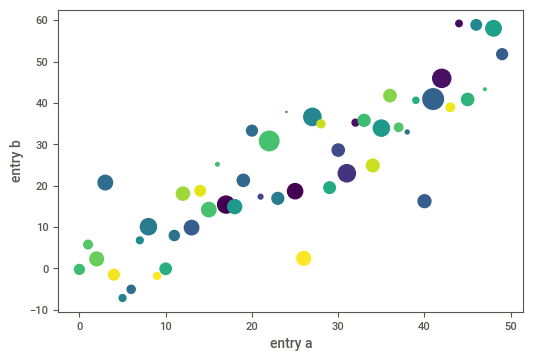

In [75]:
plt.scatter('a', 'b', c='c', s='d', data=data)
plt.xlabel('entry a')
plt.ylabel('entry b')
plt.show()

In [34]:
test_list = zip(axes, covid_df.select_dtypes(include=['float']).columns)
test_list

In [35]:
for x in test_list:
    print(x)

(<AxesSubplot:>, 'total_vaccinations')
(<AxesSubplot:>, 'people_vaccinated')
(<AxesSubplot:>, 'people_fully_vaccinated')
(<AxesSubplot:>, 'daily_vaccinations_raw')
(<AxesSubplot:>, 'daily_vaccinations')
(<AxesSubplot:>, 'total_vaccinations_per_hundred')
(<AxesSubplot:>, 'people_vaccinated_per_hundred')
(<AxesSubplot:>, 'people_fully_vaccinated_per_hundred')
(<AxesSubplot:>, 'daily_vaccinations_per_million')


In [27]:
type(test_list)

tuple

In [33]:
test_list[2]

IndexError: tuple index out of range

In [29]:
type(axes)

numpy.ndarray

In [30]:
type(covid_df.select_dtypes(include=['float']).columns)

pandas.core.indexes.base.Index

In [35]:
covid_df.profile_report()

AttributeError: 'DataFrame' object has no attribute 'profile_report'